<a href="https://colab.research.google.com/github/sertuxito/Data-Cience-II/blob/main/TrabajoFinal-SergioNavarro-CienceII_NYPD_Shooting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Abstract
##Titulo
#"Analisis de Intervenciones de la Policia de Nueva York donde se genera un intercambio de tiros"

##Hipótesis
El objetivo de este análisis y estudio es identificar las geolocalizaciones donde es más probable la ocurrencia de una baja humana si ocurre un intercambio de balas con la policía. Identificar estos lugares permitirá elaborar planes de prevención, como equipar las áreas con cámaras de seguridad, salas de primeros auxilios o establecer sectores de vigilancia permanente para evitar futuras bajas. Además, si se desarrolla un evento, se podrá alertar a los policías que van a intervenir sobre las geolocalizaciones de riesgo. Se busca encontrar una relación entre las ubicaciones de los incidentes donde el tiroteo termina en muerte.

##Motivación
La motivación detrás de este estudio es mejorar la seguridad pública y reducir las bajas humanas en incidentes de tiroteo con la policía. Al identificar las áreas de alto riesgo, se pueden implementar medidas preventivas efectivas que protejan tanto a los ciudadanos como a los oficiales de policía. Este análisis también puede ayudar a optimizar la asignación de recursos y mejorar la respuesta de emergencia en situaciones críticas.

##Audiencia
Este estudio está dirigido a las autoridades policiales, los responsables de la seguridad pública, los planificadores urbanos y los investigadores en criminología. También puede ser de interés para organizaciones comunitarias y defensores de los derechos humanos que buscan mejorar la seguridad y la justicia en sus comunidades.

##Contexto Comercial y Analítico
En el contexto comercial, este análisis puede ser utilizado por empresas de tecnología de seguridad para desarrollar soluciones innovadoras que ayuden a prevenir incidentes de tiroteo. En el ámbito analítico, los datos obtenidos pueden ser utilizados para realizar estudios más profundos sobre la relación entre la ubicación geográfica y la incidencia de tiroteos, así como para desarrollar modelos predictivos que ayuden a anticipar y prevenir futuros incidentes



In [ ]:
!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt

Cargo libreria de geopandas para que se puedan interpretar las geolocalizaciones.


In [ ]:
import pandas as pd
import numpy as np

#Se carga el csv desde raw de github

In [ ]:

# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


Analiss Exploratorio para poder ver las distintas columnas del csv

In [ ]:
df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)


Se realiza describe aunque las variabes numericas sobre las que tiene efecto esta operacion carece de significancia ya que las variables numericas del dataset son Insicent_key identificador clave del dataset que es una codificacion númerica, el numero del precinto que tanbien es un identificador unico para cada precinto policial de l aciudad, el codigo de jurisdiccion al igual que los anteriores don numeros identificadores, y luego tenemos las cooedenadas latitud y longitud donde se realizaron cada uno de los incidentes.  No es significativo ni el promedio ni la medio ni los percentiles de cada uno de estas colunas o variables.

In [ ]:
df.describe()

,INCIDENT_KEY,PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,2.856200e+04,28562.000000,28560.000000,2.856200e+04,28562.000000,28503.000000,28503.000000
mean,1.274058e+08,65.496009,0.321884,1.009424e+06,208380.075755,40.738570,-73.909099
std,7.804340e+07,27.342643,0.733035,1.830111e+04,31917.509528,0.087611,0.065967
min,9.953245e+06,1.000000,0.000000,9.149281e+05,125756.718750,40.511586,-74.249303
25%,6.543991e+07,44.000000,0.000000,1.000068e+06,182912.000000,40.668648,-73.942917
50%,9.271125e+07,67.000000,0.000000,1.007772e+06,194901.390625,40.701467,-73.915068
75%,2.031320e+08,81.000000,0.000000,1.016807e+06,239814.234375,40.824878,-73.882366
max,2.797581e+08,123.000000,2.000000,1.066815e+06,271127.687500,40.910818,-73.702046


Verificacion de duplicados en el dataset

In [ ]:
df.duplicated().sum()

0

No Hay Duplicados

In [ ]:
# INFORMACIÓN GENERAL DEL DATASET
print("\nInformación general del dataset:")
df.info()


Información general del dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28562 entries, 0 to 28561
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   INCIDENT_KEY             28562 non-null  int64  
 1   OCCUR_DATE               28562 non-null  object 
 2   OCCUR_TIME               28562 non-null  object 
 3   BORO                     28562 non-null  object 
 4   LOC_OF_OCCUR_DESC        2966 non-null   object 
 5   PRECINCT                 28562 non-null  int64  
 6   JURISDICTION_CODE        28560 non-null  float64
 7   LOC_CLASSFCTN_DESC       2966 non-null   object 
 8   LOCATION_DESC            13585 non-null  object 
 9   STATISTICAL_MURDER_FLAG  28562 non-null  bool   
 10  PERP_AGE_GROUP           19218 non-null  object 
 11  PERP_SEX                 19252 non-null  object 
 12  PERP_RACE                19252 non-null  object 
 13  VIC_AGE_GROUP            28562 non-null  o

# Descripción de variables
Diccionario de datos

INCIDENT_KEY: Identificador único para cada incidente.
   Tipo: Categórica nominal (ID)

OCCUR_DATE: Fecha en la que ocurrió el incidente MM/DD/AAAA
   Tipo: Categórica ordinal (fecha)

OCCUR_TIME: Hora en la que ocurrió el incidente HH/MM/SS
   Tipo: Categórica ordinal (hora)

BORO: Barrio o distrito donde ocurrió el incidente.
   Tipo: Categórica nominal

LOC_OF_OCCUR_DESC: Descripción de la ubicación del incidente.
   Tipo: Categórica nominal

PRECINCT: Número de precinto donde ocurrió el incidente.
  Tipo: Numérica discreta

JURISDICTION_CODE: Código de jurisdicción del incidente.
   Tipo: Numérica de razón

LOC_CLASSFCTN_DESC: Descripción de la clasificación de la ubicación.
   Tipo: Categórica nominal

LOCATION_DESC: Descripción adicional de la ubicación.
   Tipo: Categórica nominal

STATISTICAL_MURDER_FLAG: Indicador de si el incidente se considera un asesinato estadístico.
   Tipo: Categórica nominal (booleano)

PERP_AGE_GROUP: Grupo de edad del perpetrador.
   Tipo: Categórica nominal

PERP_SEX: Sexo del perpetrador.
   Tipo: Categórica nominal

PERP_RACE: Raza del perpetrador.
   Tipo: Categórica nominal

VIC_AGE_GROUP: Grupo de edad de la víctima.
   Tipo: Categórica nominal

VIC_SEX: Sexo de la víctima.
   Tipo: Categórica nominal

VIC_RACE: Raza de la víctima.
   Tipo: Categórica nominal

X_COORD_CD: Coordenada X de la ubicación del incidente.
   Tipo: Numérica de razón

Y_COORD_CD: Coordenada Y de la ubicación del incidente.
   Tipo: Numérica de razón

Latitude: Latitud de la ubicación del incidente.
   Tipo: Numérica de razón

Longitude: Longitud de la ubicación del incidente.
   Tipo: Numérica de razón

Lon_Lat: Combinación de latitud y longitud en formato de cadena.
   Tipo: Categórica nominal

#Analisis de Variables

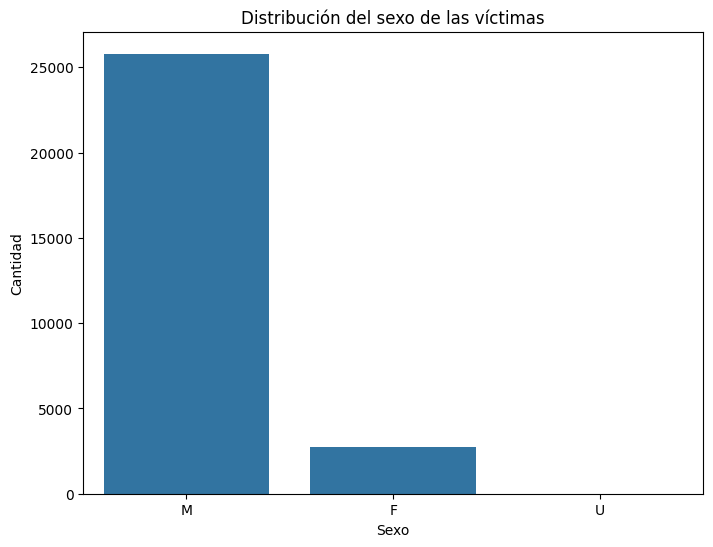

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Contar la frecuencia de cada sexo de las víctimas
sex_counts = df['VIC_SEX'].value_counts()

# Crear un gráfico de barras
plt.figure(figsize=(8, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='VIC_SEX', data=df)
plt.title('Distribución del sexo de las víctimas')
plt.xlabel('Sexo')
plt.ylabel('Cantidad')
plt.show()


Las victimas son más hombres que mujeres en el dataset analizzado siendo M (male)

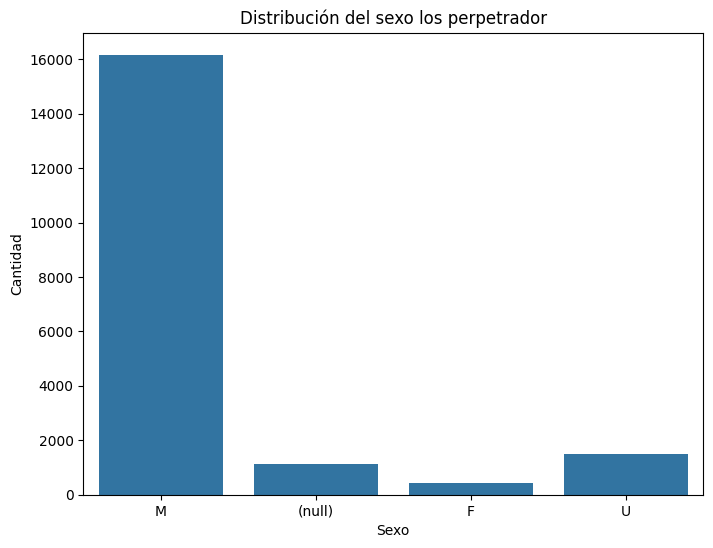

,count
PERP_SEX,
M,16168
U,1499
(null),1141
F,444


In [ ]:
# Contar la frecuencia de cada sexo de las víctimas
sex_counts = df['PERP_SEX'].value_counts()

# Crear un gráfico de barras
plt.figure(figsize=(8, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='PERP_SEX', data=df)
plt.title('Distribución del sexo los perpetrador')
plt.xlabel('Sexo')
plt.ylabel('Cantidad')
plt.show()

sex_counts

tenemos  

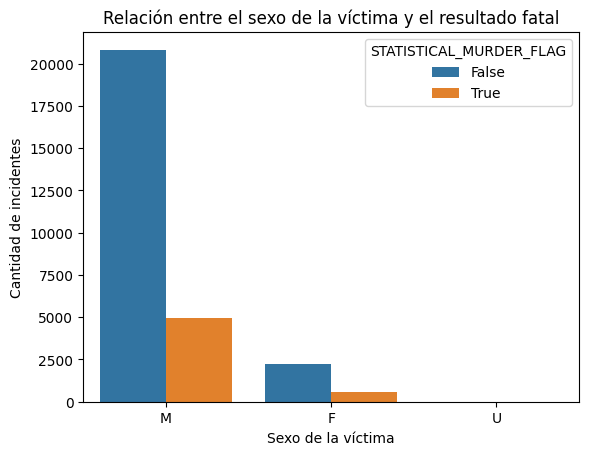

In [ ]:
 sns.countplot(x='VIC_SEX', hue='STATISTICAL_MURDER_FLAG', data=df)
 plt.title('Relación entre el sexo de la víctima y el resultado fatal')
 plt.xlabel('Sexo de la víctima')
 plt.ylabel('Cantidad de incidentes')
 plt.show()

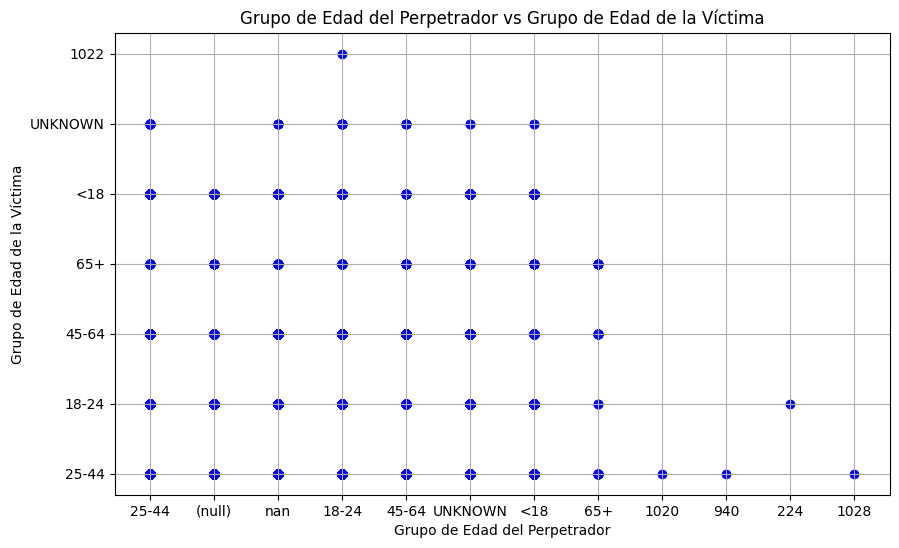

In [ ]:


#análisis y gráfico para dos variables: PERP_AGE_GROUP y VIC_AGE_GROUP
plt.figure(figsize=(10,6))

plt.scatter(df['PERP_AGE_GROUP'].astype(str), df['VIC_AGE_GROUP'].astype(str), color='blue')
plt.title('Grupo de Edad del Perpetrador vs Grupo de Edad de la Víctima')
plt.xlabel('Grupo de Edad del Perpetrador')
plt.ylabel('Grupo de Edad de la Víctima')
plt.grid(True)
plt.show()

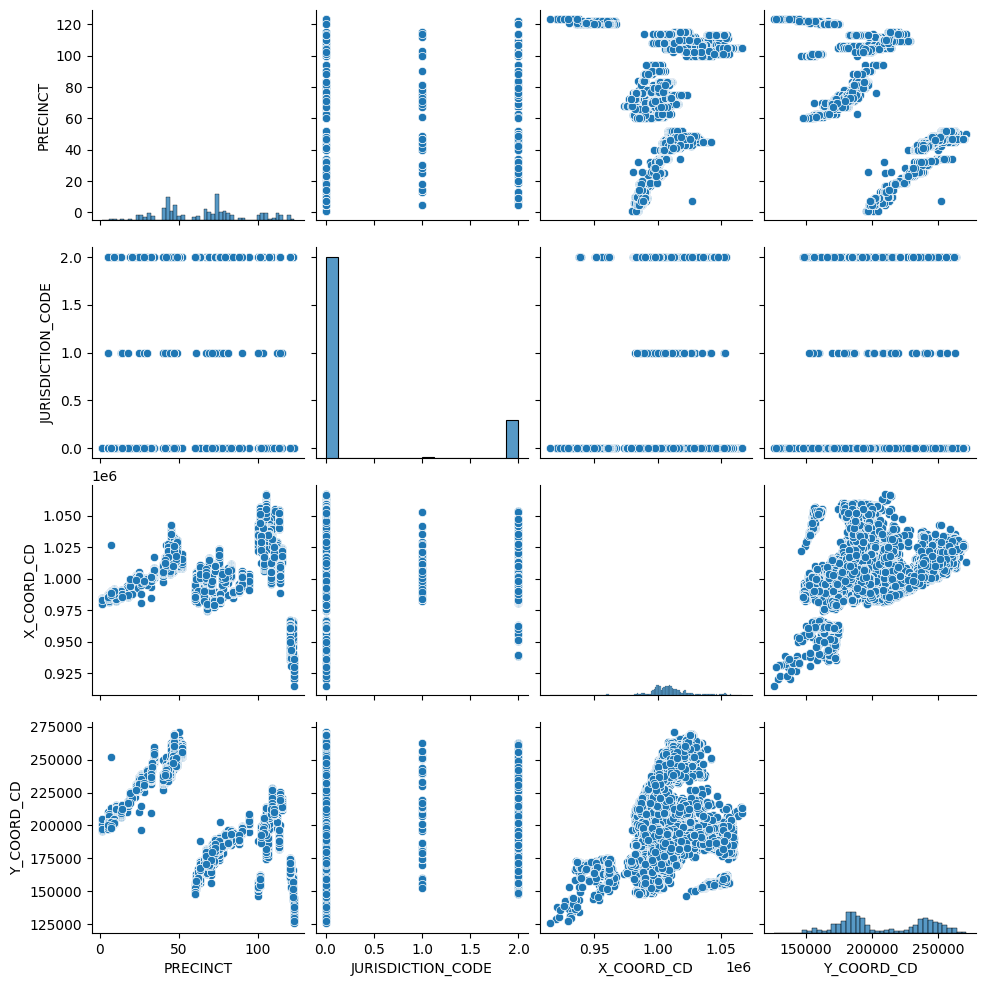

In [ ]:
# Grafico de pares
sns.pairplot(df[['PRECINCT', 'JURISDICTION_CODE', 'X_COORD_CD', 'Y_COORD_CD']])
plt.show()

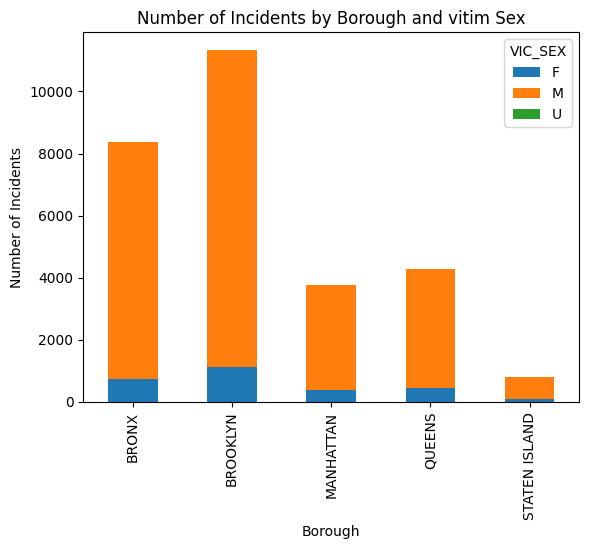

In [ ]:
# Grouped bar plot for BORO and PRECINCT
df_grouped = df.groupby(['BORO', 'VIC_SEX']).size().unstack()
df_grouped.plot(kind='bar', stacked=True)
plt.title('Number of Incidents by Borough and vitim Sex')
plt.xlabel('Borough')
plt.ylabel('Number of Incidents')
plt.show()

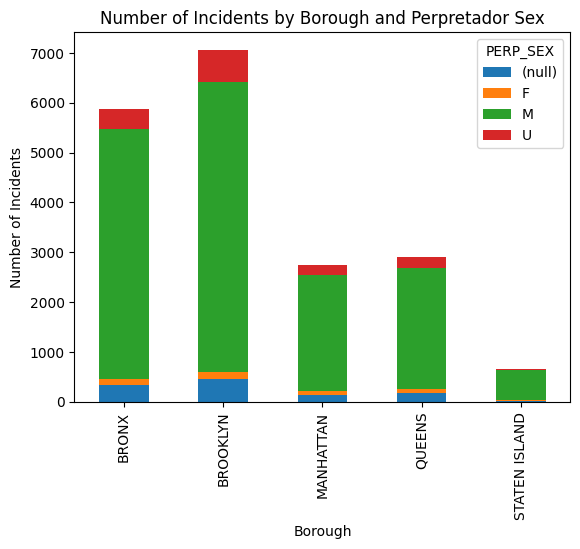

In [ ]:
# Grouped bar plot for BORO and PRECINCT
df_grouped = df.groupby(['BORO', 'PERP_SEX']).size().unstack()
df_grouped.plot(kind='bar', stacked=True)
plt.title('Number of Incidents by Borough and Perpretador Sex')
plt.xlabel('Borough')
plt.ylabel('Number of Incidents')
plt.show()

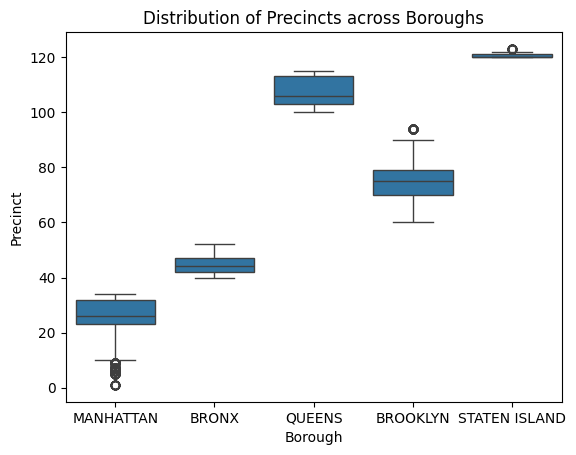

In [ ]:
# Box plot for PRECINCT across different BORO
sns.boxplot(x='BORO', y='PRECINCT', data=df)
plt.title('Distribution of Precincts across Boroughs')
plt.xlabel('Borough')
plt.ylabel('Precinct')
plt.show()

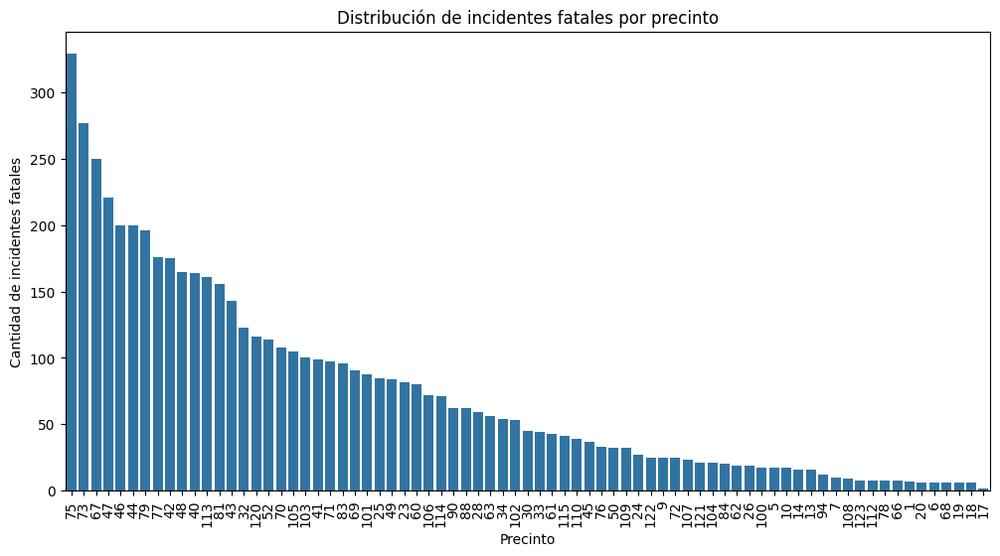

In [ ]:
# Filtrar el DataFrame para incluir solo incidentes fatales
incidentes_fatales = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Crear un gráfico de barras que muestre la distribución de incidentes fatales por precinto
plt.figure(figsize=(12, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='PRECINCT', data=incidentes_fatales, order=incidentes_fatales['PRECINCT'].value_counts().index)
plt.title('Distribución de incidentes fatales por precinto')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.show()

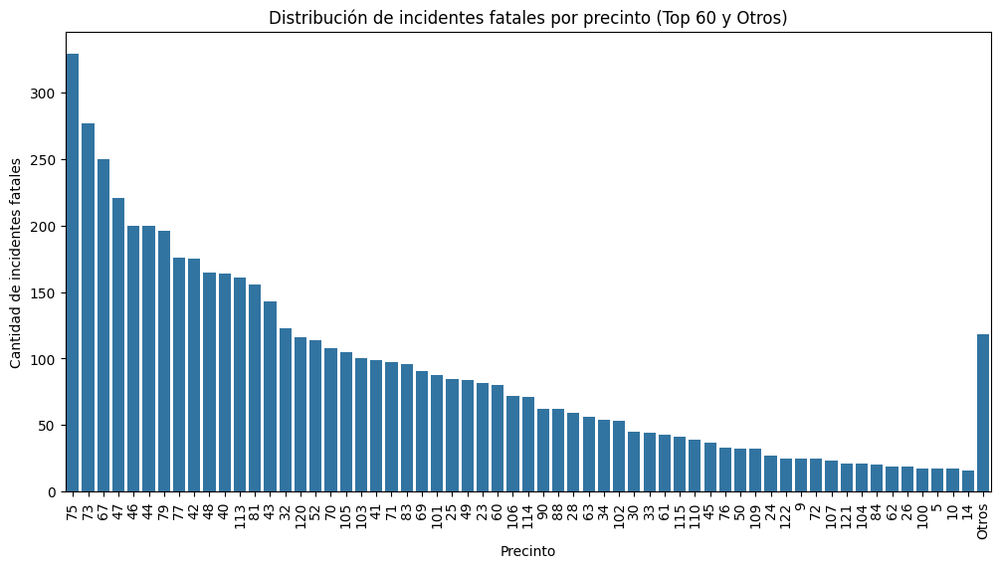

In [ ]:

# Contar la cantidad de incidentes fatales por precinto
incidentes_por_precinto = incidentes_fatales['PRECINCT'].value_counts()

# Obtener los top 20 precintos con más incidentes fatales
top_60_precintos = incidentes_por_precinto.nlargest(60)

# Sumar el resto de los incidentes fatales fuera del top 20
resto_incidentes = incidentes_por_precinto.iloc[60:].sum()

# Crear un nuevo DataFrame para el gráfico
top_60_df = pd.concat([top_60_precintos, pd.Series(resto_incidentes, index=['Otros'])])

# Crear un gráfico de barras que muestre la distribución de incidentes fatales por precinto
plt.figure(figsize=(12, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.barplot(x=top_60_df.index, y=top_60_df.values)
plt.title('Distribución de incidentes fatales por precinto (Top 60 y Otros)')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.show()

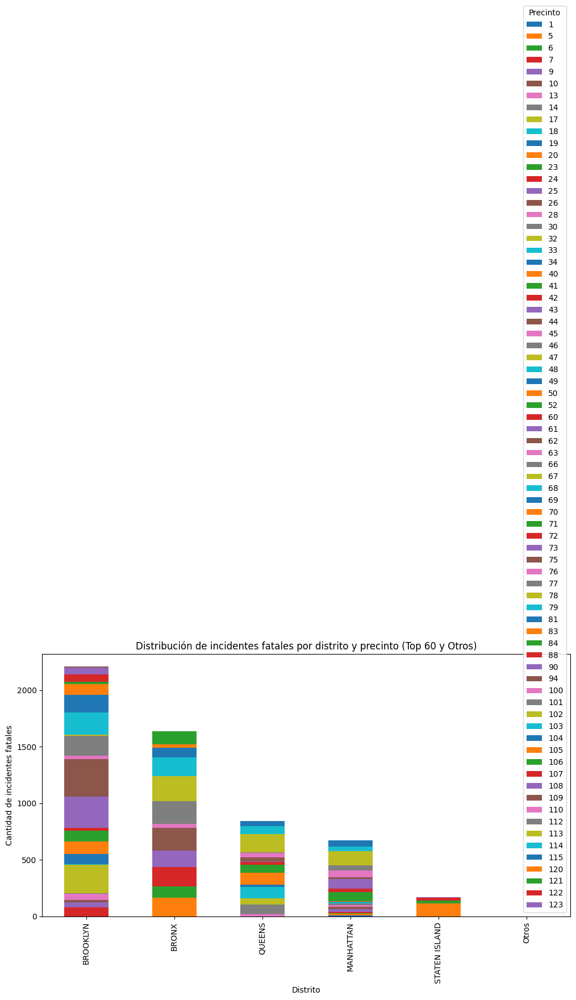

In [ ]:

# Contar la cantidad de incidentes fatales por distrito y precinto
incidentes_por_distrito_precinto = incidentes_fatales.groupby(['BORO', 'PRECINCT']).size().unstack(fill_value=0)

# Obtener los top 60 distritos con más incidentes fatales
top_60_distritos = incidentes_por_distrito_precinto.sum(axis=1).nlargest(60).index

# Filtrar el DataFrame para incluir solo los top 60 distritos
incidentes_top_60 = incidentes_por_distrito_precinto.loc[top_60_distritos]

# Sumar el resto de los incidentes fatales fuera del top 60
resto_incidentes = incidentes_por_distrito_precinto.drop(top_60_distritos).sum(axis=0)
incidentes_top_60.loc['Otros'] = resto_incidentes

# Crear un gráfico de barras apiladas que muestre la distribución de incidentes fatales por distrito y precinto
incidentes_top_60.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.title('Distribución de incidentes fatales por distrito y precinto (Top 60 y Otros)')
plt.xlabel('Distrito')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.legend(title='Precinto')
plt.show()

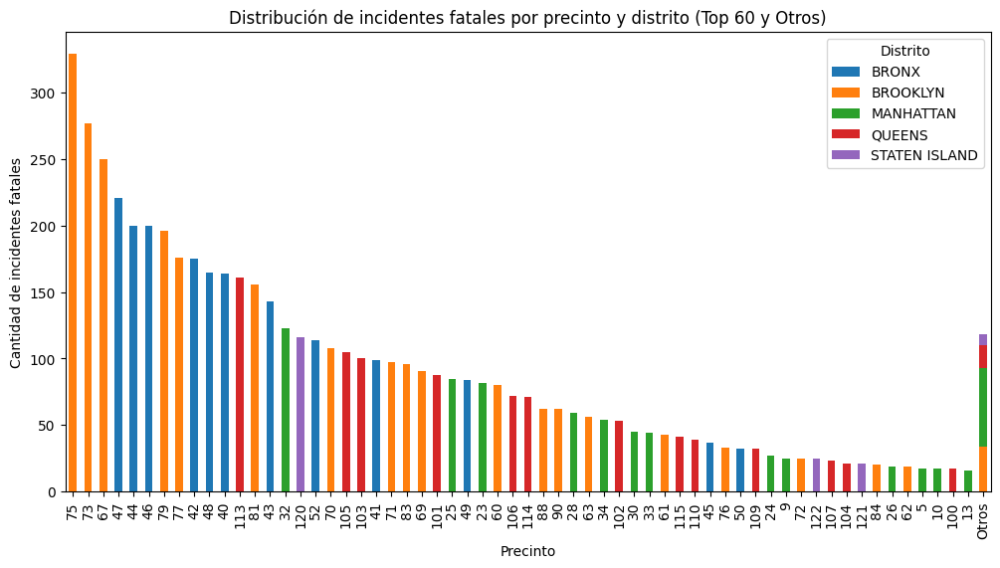

In [ ]:

# Contar la cantidad de incidentes fatales por precinto y distrito
incidentes_por_precinto_distrito = incidentes_fatales.groupby(['PRECINCT', 'BORO']).size().unstack(fill_value=0)

# Obtener los top 60 precintos con más incidentes fatales
top_60_precintos = incidentes_por_precinto_distrito.sum(axis=1).nlargest(60).index

# Filtrar el DataFrame para incluir solo los top 60 precintos
incidentes_top_60 = incidentes_por_precinto_distrito.loc[top_60_precintos]

# Sumar el resto de los incidentes fatales fuera del top 60
resto_incidentes = incidentes_por_precinto_distrito.drop(top_60_precintos).sum(axis=0)
incidentes_top_60.loc['Otros'] = resto_incidentes

# Crear un gráfico de barras apiladas que muestre la distribución de incidentes fatales por precinto y distrito
incidentes_top_60.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.title('Distribución de incidentes fatales por precinto y distrito (Top 60 y Otros)')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.legend(title='Distrito')
plt.show()

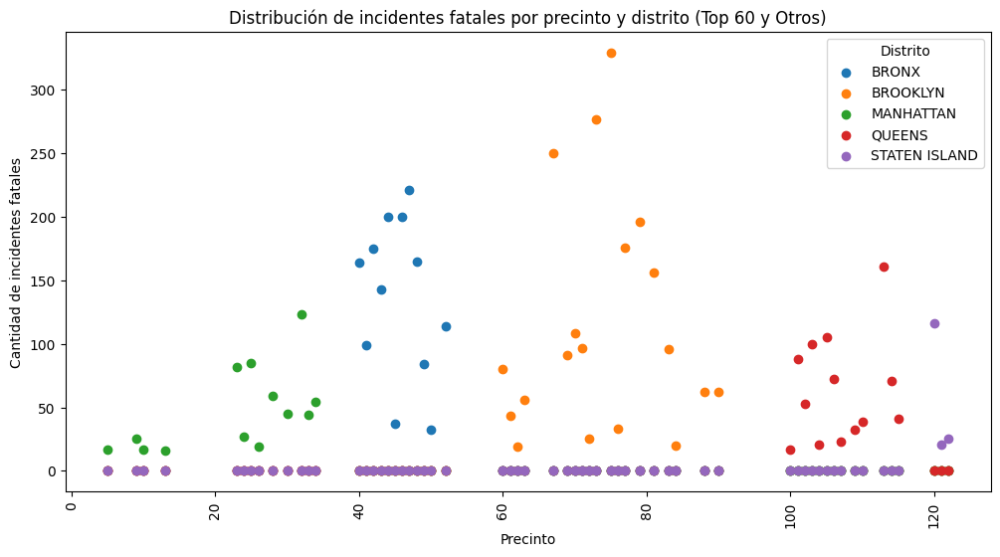

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Contar la cantidad de incidentes fatales por precinto y distrito
incidentes_por_precinto_distrito = incidentes_fatales.groupby(['PRECINCT', 'BORO']).size().unstack(fill_value=0)

# Obtener los top 60 precintos con más incidentes fatales
top_60_precintos = incidentes_por_precinto_distrito.sum(axis=1).nlargest(60).index

# Filtrar el DataFrame para incluir solo los top 60 precintos
incidentes_top_60 = incidentes_por_precinto_distrito.loc[top_60_precintos]

# Sumar el resto de los incidentes fatales fuera del top 60
resto_incidentes = incidentes_por_precinto_distrito.drop(top_60_precintos).sum(axis=0)
incidentes_top_60.loc['Otros'] = resto_incidentes

# Crear un gráfico de dispersión que muestre la distribución de incidentes fatales por precinto y distrito
plt.figure(figsize=(12, 6))
for distrito in incidentes_top_60.columns:
    # Filter out the 'Otros' row before plotting
    data_to_plot = incidentes_top_60[incidentes_top_60.index != 'Otros']
    plt.scatter(data_to_plot.index.astype(float), data_to_plot[distrito], label=distrito) # Convert index to float

plt.title('Distribución de incidentes fatales por precinto y distrito (Top 60 y Otros)')
plt.xlabel('Precinto')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.legend(title='Distrito')
plt.show()

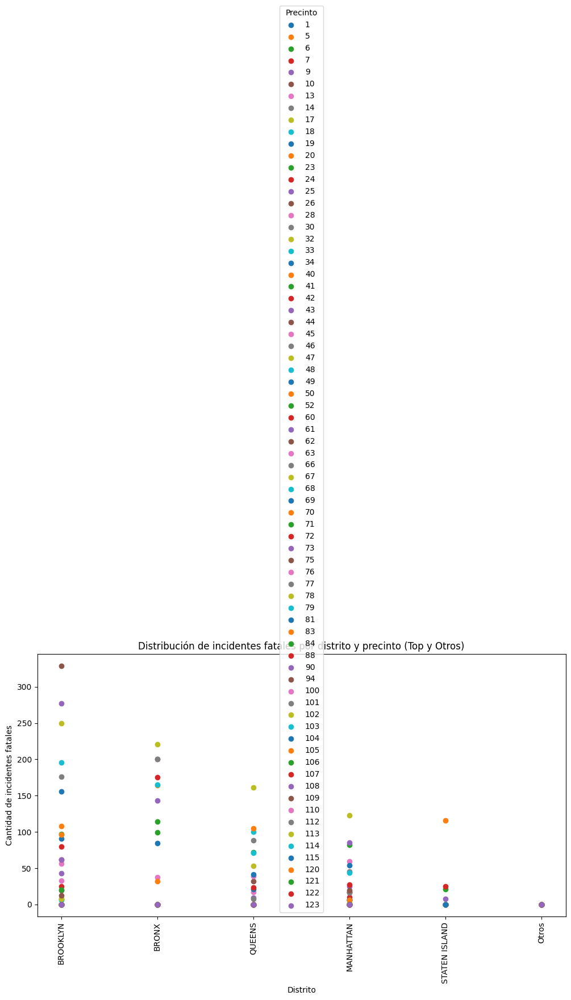

In [ ]:

# Contar la cantidad de incidentes fatales por distrito y precinto
incidentes_por_distrito_precinto = incidentes_fatales.groupby(['BORO', 'PRECINCT']).size().unstack(fill_value=0)

# Obtener los top distritos con más incidentes fatales
top_distritos = incidentes_por_distrito_precinto.sum(axis=1).nlargest(60).index

# Filtrar el DataFrame para incluir solo los top distritos
incidentes_top = incidentes_por_distrito_precinto.loc[top_distritos]

# Sumar el resto de los incidentes fatales fuera del top
resto_incidentes = incidentes_por_distrito_precinto.drop(top_distritos).sum(axis=0)
incidentes_top.loc['Otros'] = resto_incidentes

# Crear un gráfico de dispersión que muestre la distribución de incidentes fatales por distrito y precinto
plt.figure(figsize=(12,6))
for precinto in incidentes_top.columns:
    plt.scatter(incidentes_top.index, incidentes_top[precinto], label=precinto)

plt.title('Distribución de incidentes fatales por distrito y precinto (Top y Otros)')
plt.xlabel('Distrito')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90) # Rotar las etiquetas del eje x para una mejor legibilidad
plt.legend(title='Precinto')
plt.show()

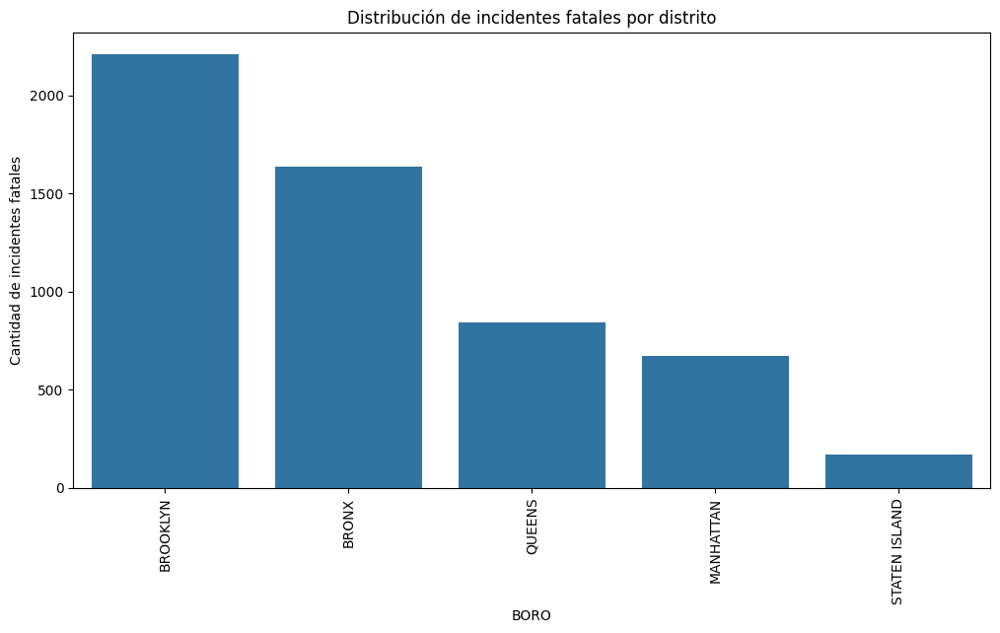

In [ ]:
# Crear un gráfico de barras que muestre la distribución de incidentes fatales por precinto
plt.figure(figsize=(12, 6))  # Ajustar el tamaño del gráfico si es necesario
sns.countplot(x='BORO', data=incidentes_fatales, order=incidentes_fatales['BORO'].value_counts().index)
plt.title('Distribución de incidentes fatales por distrito')
plt.xlabel('BORO')
plt.ylabel('Cantidad de incidentes fatales')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para una mejor legibilidad
plt.show()

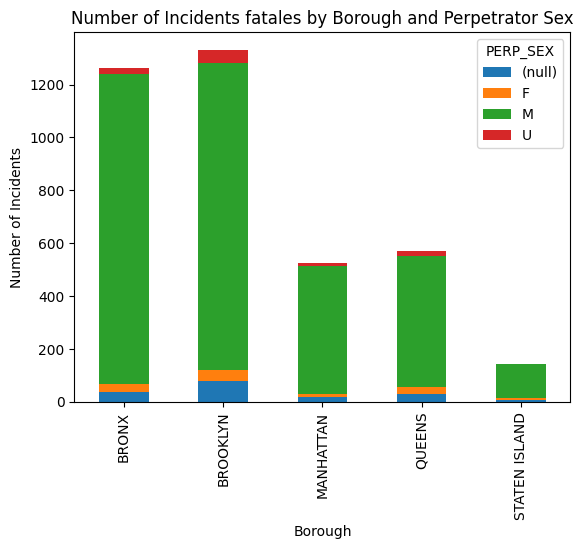

In [ ]:
# Grouped bar plot for BORO and PRECINCT
df_grouped = incidentes_fatales.groupby(['BORO', 'PERP_SEX']).size().unstack()
df_grouped.plot(kind='bar', stacked=True)
plt.title('Number of Incidents fatales by Borough and Perpetrator Sex')
plt.xlabel('Borough')
plt.ylabel('Number of Incidents')
plt.show()

In [ ]:
from shapely.geometry import Point
import matplotlib.pyplot as plt

In [ ]:

!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import folium


In [ ]:
# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude']]
y = df['STATISTICAL_MURDER_FLAG']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Crear un mapa centrado en una ubicación específica
m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=12)

for idx, row in df.iterrows():
    color = 'red' if row['STATISTICAL_MURDER_FLAG'] else 'green'
    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)

m

En este grafico vemos la ubicacion de todos los incidentes que involucraron intercambio de balas con NYPD donde los circulos verdes no involucran bajas fatales y los de circulos rojos si.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG', 'OCCUR_TIME']].dropna()

# Convertir la columna 'OCCUR_TIME' a una variable numérica (por ejemplo, minutos desde la medianoche)
df['Tiempo de ocurrencia'] = df['OCCUR_TIME'].apply(lambda x: int(x.split(':')[0]) * 60 + int(x.split(':')[1]))

# Dividir los datos en características (X) y etiqueta (y)
X = df[['Latitude', 'Longitude', 'Tiempo de ocurrencia']]
y = df['STATISTICAL_MURDER_FLAG'].astype(int)  # Convertir booleanos a enteros (0 y 1)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Sobremuestreo de la clase minoritaria usando SMOTE
smote = SMOTE(random_state=42)
X_resampled_smote, y_resampled_smote = smote.fit_resample(X_train, y_train)

# Submuestreo de la clase mayoritaria usando RandomUnderSampler
undersample = RandomUnderSampler(random_state=42)
X_resampled_under, y_resampled_under = undersample.fit_resample(X_train, y_train)

In [ ]:
# Crear un modelo de Ramdom Forest
model = RandomForestClassifier(n_estimators=100, random_state=42)

# Entrenar y evaluar el modelo con sobremuestreo (SMOTE)
model.fit(X_resampled_smote, y_resampled_smote)
y_pred_smote = model.predict(X_test)
accuracy_smote = accuracy_score(y_test, y_pred_smote)

print("Resultados con SMOTE (Sobremuestreo):")
print(classification_report(y_test, y_pred_smote))
print(confusion_matrix(y_test, y_pred_smote))

Resultados con SMOTE (Sobremuestreo):
              precision    recall  f1-score   support

           0       0.84      0.75      0.79      4617
           1       0.27      0.40      0.32      1084

    accuracy                           0.69      5701
   macro avg       0.56      0.58      0.56      5701
weighted avg       0.73      0.69      0.71      5701

[[3475 1142]
 [ 653  431]]


STATISTICAL_MURDER_FLAG'  es true (1)  si termina en muerte y False (0) si no hay victimas fatales

Clase 0: 3475 verdaderos negativos, 1142 falsos positivos

Clase 1: 653 falsos negativos, 431 verdaderos positivos

Interpretación:


Clase 0 (mayoría los que no terminaron en muerte): La precisión es alta (0.84) y la sensibilidad es buena (0.75), lo que indica que el modelo es bastante efectivo en identificar correctamente los negativos.

Clase 1 (minoría los incidentes que terminaron en muerte fatal ): La precisión es baja (0.27) y la sensibilidad es moderada (0.40), lo que sugiere que el modelo aún tiene dificultades para identificar correctamente los positivos, aunque ha mejorado en comparación con el submuestreo.

Conclusión: El modelo tiene un rendimiento general mejorado en comparación con el submuestreo, especialmente en términos de exactitud (0.69). Sin embargo, sigue habiendo un desequilibrio en el rendimiento entre las clases, con la clase minoritaria (1) aún presentando desafíos en términos de precisión y sensibilidad.

In [ ]:
# Entrenar y evaluar el modelo con submuestreo (RandomUnderSampler)
model.fit(X_resampled_under, y_resampled_under)
y_pred_under = model.predict(X_test)
accuracy_under = accuracy_score(y_test, y_pred_under)

print("Resultados con RandomUnderSampler (Submuestreo):")
print(classification_report(y_test, y_pred_under))
print(confusion_matrix(y_test, y_pred_under))

Resultados con RandomUnderSampler (Submuestreo):
              precision    recall  f1-score   support

           0       0.86      0.57      0.69      4617
           1       0.25      0.60      0.35      1084

    accuracy                           0.58      5701
   macro avg       0.55      0.59      0.52      5701
weighted avg       0.74      0.58      0.62      5701

[[2652 1965]
 [ 434  650]]


TATISTICAL_MURDER_FLAG' es true (1) si termina en muerte y False (0) si no hay victimas fatales

Clase 0: 2652 verdaderos negativos, 1965 falsos positivos

Clase 1: 434 falsos negativos, 650 verdaderos positivos

Interpretación:

Clase 0 (mayoría): La precisión es alta (0.86), pero la sensibilidad es moderada (0.57), lo que indica que el modelo es bueno para identificar correctamente los negativos, pero pierde algunos positivos.

Clase 1 (minoría): La precisión es baja (0.25), pero la sensibilidad es relativamente alta (0.60), lo que sugiere que el modelo identifica correctamente más de la mitad de los positivos, aunque con muchos falsos positivos.

Conclusión: El modelo tiene un rendimiento desigual entre las clases, con mejor desempeño en la clase mayoritaria (0) que en la minoritaria (1). Esto es común en problemas de desequilibrio de clases. El uso de RandomUnderSampler ha mejorado la detección de la clase minoritaria, pero a costa de una mayor tasa de falsos positivos.

# Otro Enfoque
##Distacias entre las posiciones
Intentare otro enfoque pensando en la distancia de las coordenadas entre si....
Y la distancia al punto más cercano donde hubo una baja humana

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns  # Importa la librería Seaborn para visualización de datos

vuelvo a cargar el dataset original

In [ ]:
# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [ ]:
# COMPROBACIÓN DE VALORES NULOS
print("\nCantidad de valores nulos por columna:")
display(df.isnull().sum())


Cantidad de valores nulos por columna:


,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25596
LOCATION_DESC,14977
STATISTICAL_MURDER_FLAG,0


In [ ]:
# Filtrar las columnas relevantes y manejar valores nulos por la comprobacion anterior Statistical_murder_flag no tiene valores nulos,
#latitude y longitude tienen 59 valores nulos se decide eliminarlos ya que no son representativos en el universo de datos que se analiza
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from scipy.spatial import distance_matrix


#  Genero una matriz de distancias entre las coordenadas del dataset
coords = df[['Latitude', 'Longitude']].to_numpy()
dist_matrix = distance_matrix(coords, coords)



In [ ]:
dist_matrix

array([[0.        , 0.1493347 , 0.22998598, ..., 0.11572581, 0.1652443 ,
        0.06251005],
       [0.1493347 , 0.        , 0.18382708, ..., 0.03694176, 0.16445813,
        0.08725013],
       [0.22998598, 0.18382708, 0.        , ..., 0.17168021, 0.07290688,
        0.20391406],
       ...,
       [0.11572581, 0.03694176, 0.17168021, ..., 0.        , 0.13918787,
        0.05601132],
       [0.1652443 , 0.16445813, 0.07290688, ..., 0.13918787, 0.        ,
        0.15310871],
       [0.06251005, 0.08725013, 0.20391406, ..., 0.05601132, 0.15310871,
        0.        ]])

In [ ]:
# Características basadas en distancia

df['dist_min_fatalShooting'] = [
    min(dist_matrix[i][df['STATISTICAL_MURDER_FLAG']][dist_matrix[i][df['STATISTICAL_MURDER_FLAG'] ] > 0])
    if any(df['STATISTICAL_MURDER_FLAG'] ) else np.inf
    for i in range(len(df))
]

df

,Latitude,Longitude,STATISTICAL_MURDER_FLAG,dist_min_fatalShooting
0,40.754692,-73.993500,True,0.001901
1,40.854402,-73.882330,True,0.000904
2,40.710634,-73.767773,False,0.001157
3,40.832417,-73.890714,False,0.001033
4,40.688443,-73.910219,False,0.001729
...,...,...,...,...
28557,40.903785,-73.850098,True,0.000008
28558,40.825549,-73.890195,False,0.000014
28559,40.821404,-73.898938,True,0.001559
28560,40.695717,-73.839138,False,0.000896


El nuevo dataset obtenido contiene una posición si corresponde o no a un evento que derivo en una muerte y la distacia minima a otro evento donde efectivamente derivo en muerte.


In [ ]:
# Dividir en datos de entrenamiento y prueba
X = df[['dist_min_fatalShooting']]
y = df['STATISTICAL_MURDER_FLAG']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar un modelo de clasificación
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
print(f"Accuracy: {accuracy_score(y_test, y_pred):.2f}")

Accuracy: 0.77


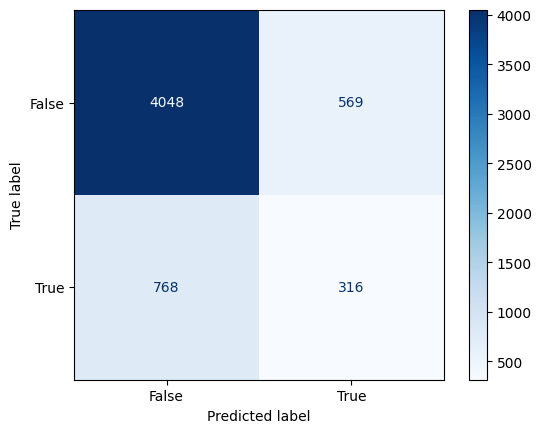

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Calcular la matriz de confusión
cm = confusion_matrix(y_test, y_pred)

# Visualizar la matriz de confusión
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.show()

In [ ]:
print(cm)


[[4048  569]
 [ 768  316]]


Cálculo de las métricas de rendimiento:

Precisión: (TP + TN) / (TP + TN + FP + FN) = (316 + 4048) / (316 + 4048 + 569 + 768) = 0,78 o 78%.

Precisión: TP / (TP + FP) = 316 / (316 + 569) = 0,357 o 35,7%.

Recuperación: TP / (TP + FN) = 316 / (316 + 768) = 0,292 o 29,2%.

Puntuación F1: 2 * (Precisión * Recuperación) / (Precisión + Recuperación) = 2 * (0,357 * 0,292) / (0,357 + 0,292) = 0,321 o 32,1%.



Recordemos  que nuestro  objetivo es predecir la probabilidad de muerte en un tiroteo policial. Esto es lo que nos dicen estas métricas en este contexto:

Precisión: El modelo acierta aproximadamente el 78% de las veces en sus predicciones. Esto puede parecer decente, pero es importante fijarse en las demás métricas, sobre todo teniendo en cuenta la gravedad del problema.

Precisión: El modelo acierta alrededor del 78% de las veces en sus predicciones. Esto puede parecer decente, pero es importante fijarse en las demás métricas, sobre todo teniendo en cuenta la gravedad del problema.
Precisión: Cuando el modelo predice una muerte, sólo acierta el 35,7% de las veces. Esto significa que hay muchos falsos positivos: el modelo predice muertes que en realidad no se producen. En su contexto, esto podría provocar una alarma innecesaria o una mala asignación de recursos.

Recordemos: El modelo sólo identifica correctamente alrededor del 29,2% de las muertes reales. Se trata de un problema importante porque significa que el modelo está pasando por alto muchos casos en los que se produjo una muerte, lo que supone un elevado número de falsos negativos. En este caso, los falsos negativos son más problemáticos que los falsos positivos, ya que representan oportunidades perdidas de evitar un desenlace trágico.

Puntuación F1: La puntuación F1 es baja (32,1%), lo que refleja el escaso equilibrio entre precisión y recuperación.
Evaluación general:

Aunque la exactitud global puede parecer razonablemente buena a primera vista, la baja precisión y sobre todo la baja recuperación son preocupantes para esta aplicación específica. El modelo no predice las muertes de forma fiable y pasa por alto un número considerable de muertes reales.


#Nuevo enfoque Klusterizacion  Aprendizaje no supervisado

Canbiando de enfoque buscando agrupar geolocalizaciones propensas a muertes fatales en un shooting con NYPD

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [ ]:
# Filtrar las columnas relevantes y manejar valores nulos
df = df[['Latitude', 'Longitude', 'STATISTICAL_MURDER_FLAG']].dropna()

<ipython-input-12-1add58ef30eb>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_murder['cluster'] = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])


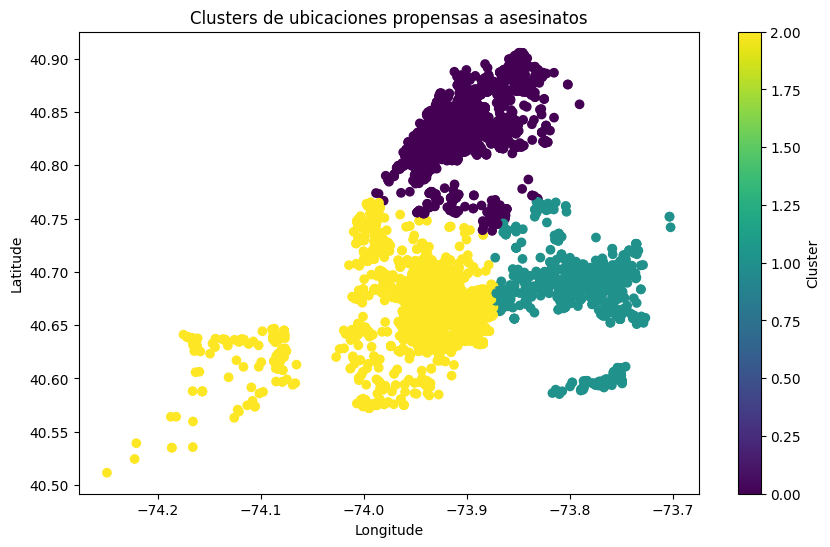

In [ ]:


# Filtrar solo las ubicaciones con murderFlag True
df_murder = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_murder['cluster'] = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

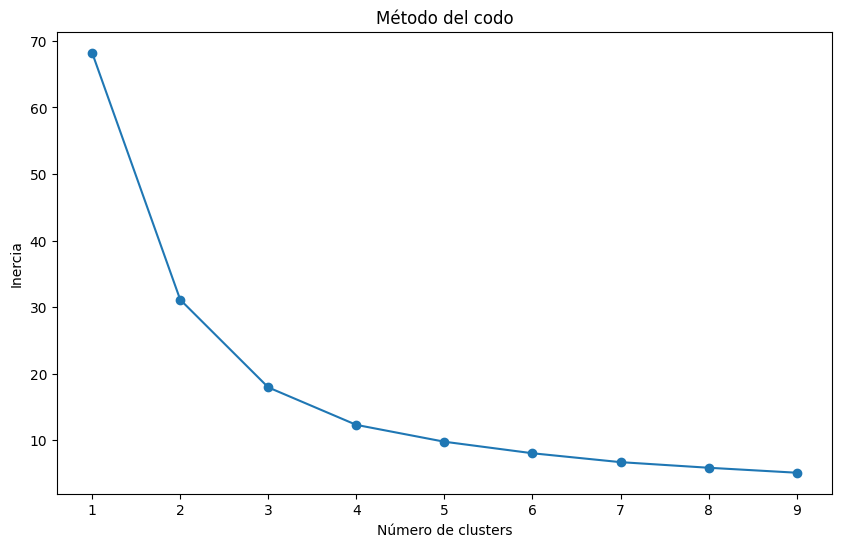

In [ ]:
# Calcular la inercia para diferentes números de clusters
inercia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_murder[['Latitude', 'Longitude']])
    inercia.append(kmeans.inertia_)

# Graficar la inercia
plt.figure(figsize=(10, 6))
plt.plot(range(1, 10), inercia, marker='o') # Changed this line
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.title('Método del codo')
plt.show()

Segun la interpretacion del medodo del codo .. la cantidad de klusters apropiada para mi data set son 3

In [ ]:
from sklearn.metrics import silhouette_score

# Calcular el coeficiente de silueta
kmeans = KMeans(n_clusters=3, random_state=42)
labels = kmeans.fit_predict(df_murder[['Latitude', 'Longitude']])
silhouette_avg = silhouette_score(df_murder[['Latitude', 'Longitude']], labels)

print(f"Coeficiente de Silueta: {silhouette_avg:.2f}")

Coeficiente de Silueta: 0.59


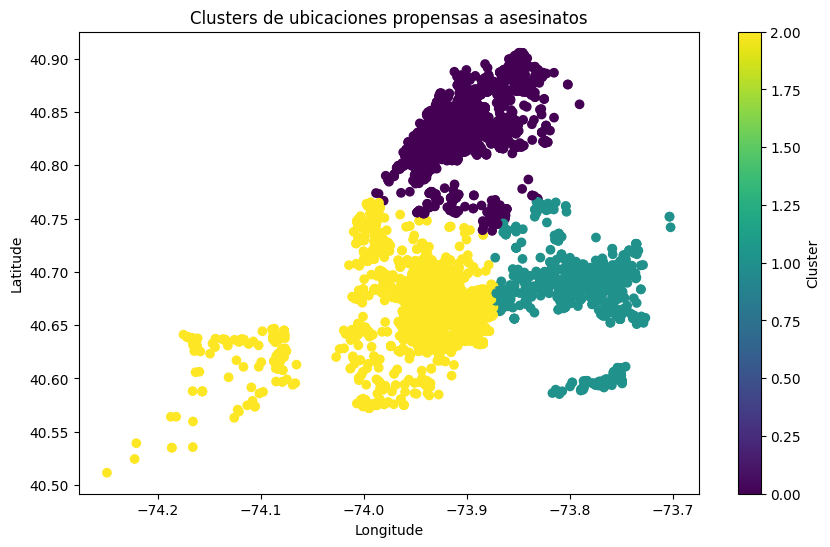

In [ ]:
# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
df_murder


,Latitude,Longitude,STATISTICAL_MURDER_FLAG,cluster
0,40.754692,-73.993500,True,2
1,40.854402,-73.882330,True,0
6,40.673306,-73.789887,True,1
9,40.860463,-73.865561,True,0
11,40.769744,-73.909872,True,0
...,...,...,...,...
28544,40.634916,-73.932963,True,2
28549,40.700826,-73.881490,True,2
28551,40.695772,-73.979528,True,2
28557,40.903785,-73.850098,True,0


In [ ]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_murder['Latitude'].mean(), df_murder['Longitude'].mean()], zoom_start=11)

for idx, row in df_murder.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

Aplicar medor DBSCAN para kusterizar segun densidad

<ipython-input-18-d3164096e5a2>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_murder['cluster'] = dbscan.fit_predict(df_murder[['Latitude', 'Longitude']])


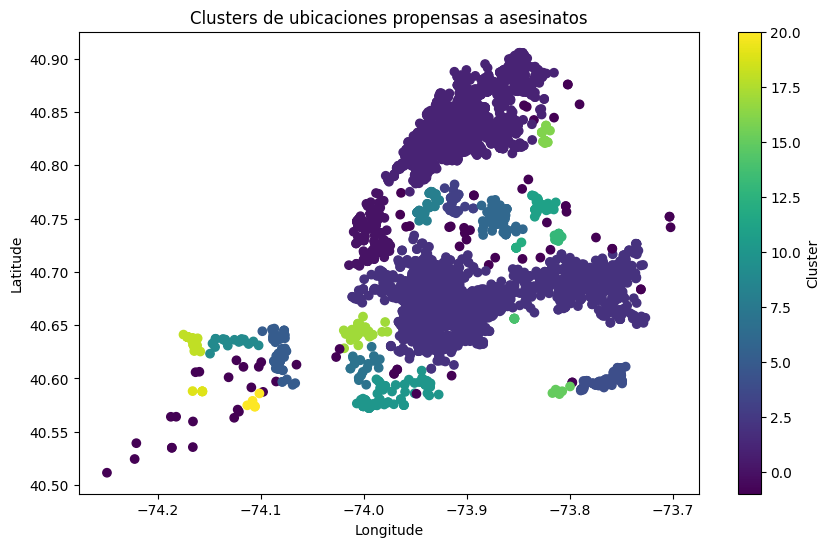

In [ ]:
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Filtrar solo las ubicaciones con murderFlag True
df_murder = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Aplicar DBSCAN
dbscan = DBSCAN(eps=0.01, min_samples=5)
df_murder['cluster'] = dbscan.fit_predict(df_murder[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_murder['Longitude'], df_murder['Latitude'], c=df_murder['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

Utilizanso DBSCAN que es un algoritmo que evalua densidad identifica 4 grupos o klusters (0,1,2,3)

In [ ]:
df_murder

,Latitude,Longitude,STATISTICAL_MURDER_FLAG,cluster
0,40.754692,-73.993500,True,0
1,40.854402,-73.882330,True,1
6,40.673306,-73.789887,True,2
9,40.860463,-73.865561,True,1
11,40.769744,-73.909872,True,3
...,...,...,...,...
28544,40.634916,-73.932963,True,2
28549,40.700826,-73.881490,True,2
28551,40.695772,-73.979528,True,2
28557,40.903785,-73.850098,True,1


In [ ]:

!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt
!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd

import folium

# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_murder['Latitude'].mean(), df_murder['Longitude'].mean()], zoom_start=11)

for idx, row in df_murder.iterrows():
    if row['cluster'] == 0:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    elif row['cluster'] == 2:
        color = 'yellow'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

De esta manera puedo ubicar en el mapa de nueva york los 4 klusters segun DBSCAN

In [ ]:

!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt
!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd

import folium


EN este nuevo analisis sectorizaremos por intervalos horario

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [ ]:
# Convertir la columna de horas a tipo datetime
df['OCCUR_TIME'] = pd.to_datetime(df['OCCUR_TIME'], format='%H:%M:%S').dt.time
df


,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Rango_Horario
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),Madrugada
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),Noche
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),Noche
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),Noche
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),Noche
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),Noche
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),Madrugada
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),Tarde
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),Mañana


In [ ]:

# Definir los rangos horarios
def obtener_rango_horario(hora):
    if hora >= pd.to_datetime('00:00:00').time() and hora < pd.to_datetime('06:00:00').time():
        return 'Madrugada'
    elif hora >= pd.to_datetime('06:00:00').time() and hora < pd.to_datetime('12:00:00').time():
        return 'Mañana'
    elif hora >= pd.to_datetime('12:00:00').time() and hora < pd.to_datetime('18:00:00').time():
        return 'Tarde'
    else:
        return 'Noche'

# Aplicar la función para crear una nueva columna con los rangos horarios
df['Rango_Horario'] = df['OCCUR_TIME'].apply(obtener_rango_horario)

df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Rango_Horario
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),Madrugada
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),Noche
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),Noche
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),Noche
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),Noche
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),Noche
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),Madrugada
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),Tarde
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),Mañana


<ipython-input-27-05e8f515e61c>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_accident['OCCUR_TIME'] = pd.to_datetime(df_accident['OCCUR_TIME'], format='%H:%M:%S', errors='coerce').dt.hour


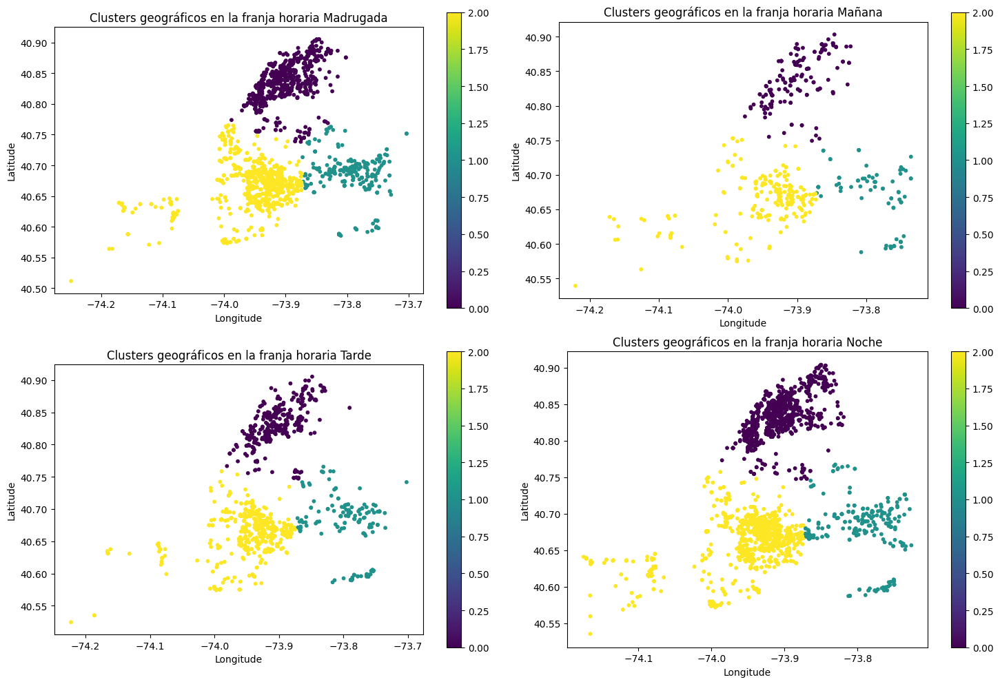

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from shapely.geometry import Point
# Import geopandas
import geopandas as gpd # This line was missing


# Filtrar solo las ubicaciones con accidentFlag True
df_accident = df[df['STATISTICAL_MURDER_FLAG'] == True]

# Convertir la columna 'time' a datetime y extraer la hora, manejando posibles errores
df_accident['OCCUR_TIME'] = pd.to_datetime(df_accident['OCCUR_TIME'], format='%H:%M:%S', errors='coerce').dt.hour

# Eliminar filas con NaNs en 'OCCUR_TIME', 'Latitude' o 'Longitude'
df_accident = df_accident.dropna(subset=['OCCUR_TIME', 'Latitude', 'Longitude'])

# Primer Nivel de Clustering (por ubicación geográfica)
kmeans_geo = KMeans(n_clusters=3, random_state=42)
df_accident['geo_cluster'] = kmeans_geo.fit_predict(df_accident[['Latitude', 'Longitude']])



# Aplicar la función para crear una nueva columna con los rangos horarios
df_accident['Rango_Horario'] = df_accident['OCCUR_TIME'].apply(lambda x: obtener_rango_horario(pd.to_datetime(f'{x}:00:00').time()))

# Convertir el DataFrame a un GeoDataFrame
geometry = [Point(xy) for xy in zip(df_accident['Longitude'], df_accident['Latitude'])]
gdf = gpd.GeoDataFrame(df_accident, geometry=geometry)

# Crear un gráfico con cuatro cuadros
fig, axs = plt.subplots(2, 2, figsize=(15, 10))

# Visualizar los resultados del clustering geográfico según distintas franjas horarias
for i, rango_horario in enumerate(['Madrugada', 'Mañana', 'Tarde', 'Noche']):
    subset = gdf[gdf['Rango_Horario'] == rango_horario]
    ax = axs[i // 2, i % 2]
    subset.plot(ax=ax, column='geo_cluster', cmap='viridis', legend=True, markersize=10)
    ax.set_title(f'Clusters geográficos en la franja horaria {rango_horario}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from shapely.geometry import Point
# Import geopandas
import geopandas as gpd # This line was missing


# Filtrar solo las ubicaciones con accidentFlag True
df_fatalResoult = df[df['STATISTICAL_MURDER_FLAG'] == True]

df_fatalResoult

# Convertir la columna 'time' a datetime y extraer la hora, manejando posibles errores
df_fatalResoult['OCCUR_TIME'] = pd.to_datetime(df_fatalResoult['OCCUR_TIME'], format='%H:%M:%S', errors='coerce').dt.hour

# Eliminar filas con NaNs en 'OCCUR_TIME', 'Latitude' o 'Longitude'
df_fatalResoult = df_fatalResoult.dropna(subset=['OCCUR_TIME', 'Latitude', 'Longitude'])

# Primer Nivel de Clustering (por ubicación geográfica)
kmeans_geo = KMeans(n_clusters=3, random_state=42)
df_fatalResoult['geo_cluster'] = kmeans_geo.fit_predict(df_fatalResoult[['Latitude', 'Longitude']])



<ipython-input-28-6a24d2184114>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_fatalResoult['OCCUR_TIME'] = pd.to_datetime(df_fatalResoult['OCCUR_TIME'], format='%H:%M:%S', errors='coerce').dt.hour


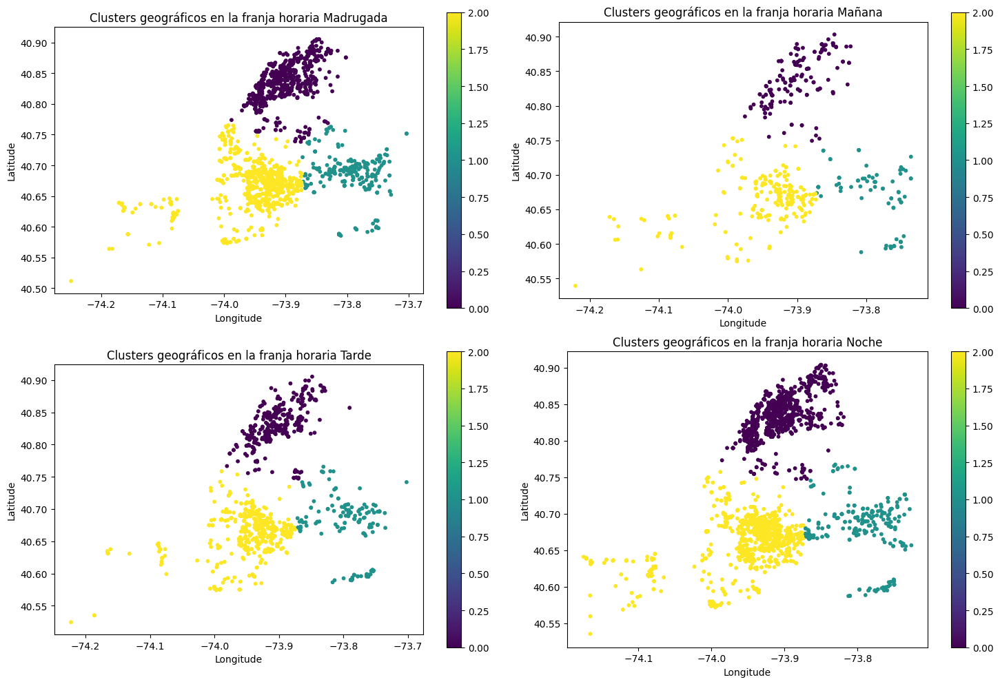

In [ ]:
# Convertir el DataFrame a un GeoDataFrame
geometry = [Point(xy) for xy in zip(df_fatalResoult['Longitude'], df_fatalResoult['Latitude'])]
gdf = gpd.GeoDataFrame(df_fatalResoult, geometry=geometry)

# Crear un gráfico con cuatro cuadros
fig, axs = plt.subplots(2, 2, figsize=(15, 10))

# Visualizar los resultados del clustering geográfico según distintas franjas horarias
for i, rango_horario in enumerate(['Madrugada', 'Mañana', 'Tarde', 'Noche']):
    subset = gdf[gdf['Rango_Horario'] == rango_horario]
    ax = axs[i // 2, i % 2]
    subset.plot(ax=ax, column='geo_cluster', cmap='viridis', legend=True, markersize=10)
    ax.set_title(f'Clusters geográficos en la franja horaria {rango_horario}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

plt.tight_layout()
plt.show()



In [ ]:
import pandas as pd
# Filtrar los datasets por franja horaria
df_madrugada = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Madrugada']
df_manana = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Mañana']
df_tarde = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Tarde']
df_noche = df_fatalResoult[df_fatalResoult['Rango_Horario'] == 'Noche']

In [ ]:
!pip install geopandas
import geopandas as gpd
import matplotlib.pyplot as plt
!pip install pandas numpy scikit-learn folium geopandas
import pandas as pd

import folium


<ipython-input-31-bd794b9d730a>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_madrugada['cluster'] = kmeans.fit_predict(df_madrugada[['Latitude', 'Longitude']])


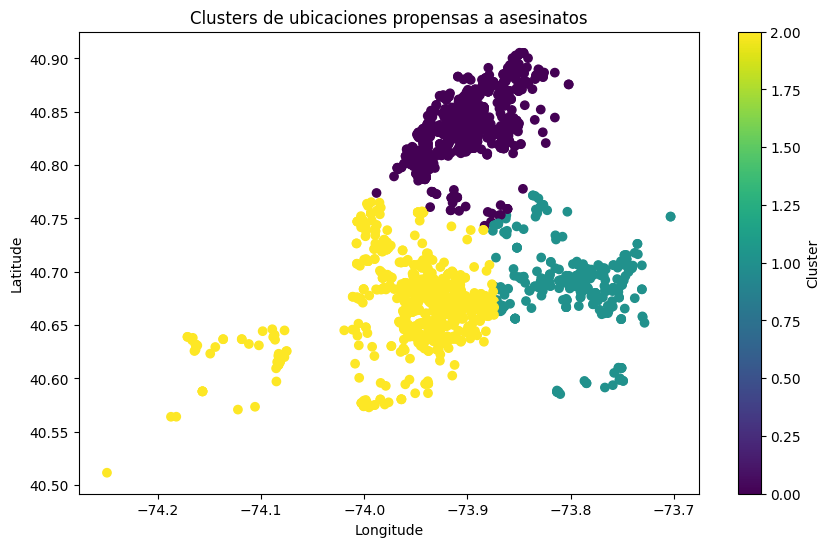

In [ ]:

# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_madrugada['cluster'] = kmeans.fit_predict(df_madrugada[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_madrugada['Longitude'], df_madrugada['Latitude'], c=df_madrugada['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_madrugada['Latitude'].mean(), df_madrugada['Longitude'].mean()], zoom_start=11)

for idx, row in df_madrugada.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

<ipython-input-23-7b58ccf107b7>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_manana['cluster'] = kmeans.fit_predict(df_manana[['Latitude', 'Longitude']])


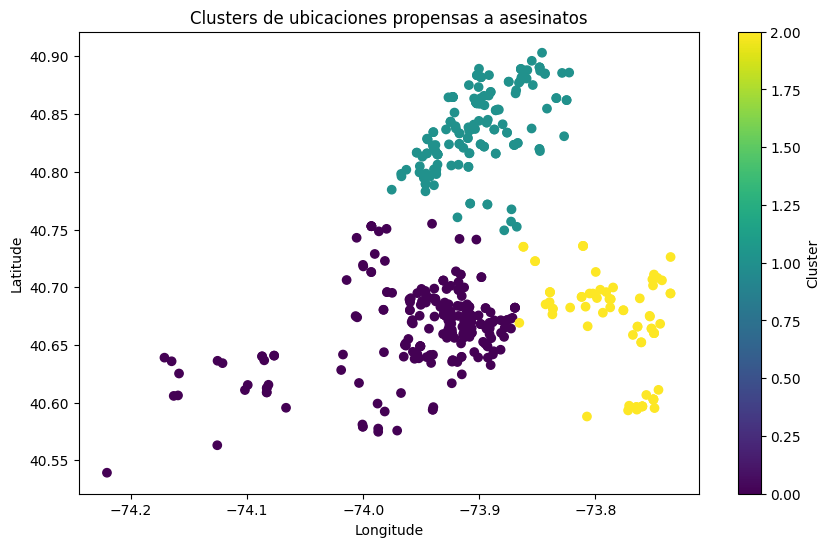

In [ ]:
# Aplicar K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
df_manana['cluster'] = kmeans.fit_predict(df_manana[['Latitude', 'Longitude']])

# Visualizar los resultados
plt.figure(figsize=(10, 6))
plt.scatter(df_manana['Longitude'], df_manana['Latitude'], c=df_manana['cluster'], cmap='viridis', marker='o')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Clusters de ubicaciones propensas a asesinatos')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
# Crear un mapa centrado en una ubicación específica siendo la media de las latitudes y longotudes
m = folium.Map(location=[df_manana['Latitude'].mean(), df_manana['Longitude'].mean()], zoom_start=11)

for idx, row in df_manana.iterrows():
    if row['cluster'] == 2:
        color = 'red'
    elif row['cluster'] == 1:
        color = 'green'
    else:
        color = 'blue'

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius=2, color=color).add_to(m)
m

In [49]:
# Importar librerías
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
sns.set(style="whitegrid")

import warnings
warnings.filterwarnings('ignore')

In [50]:
# Cargar un CSV de GitHub
url='https://raw.githubusercontent.com/sertuxito/Data-Cience-II/refs/heads/main/NYPD_Shooting_Incident_Data__Historic_.csv'
df=pd.read_csv(url,sep=',',header=0)
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,05/05/2022,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,07/04/2022,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,05/27/2012,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,09/24/2019,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,02/25/2007,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,03/19/2023,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,08/16/2023,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,06/27/2023,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,07/08/2023,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [51]:
df.describe(include=['object']).T

,count,unique,top,freq
OCCUR_DATE,28562,6095,07/05/2020,47
OCCUR_TIME,28562,1423,23:30:00,185
BORO,28562,5,BROOKLYN,11346
LOC_OF_OCCUR_DESC,2966,2,OUTSIDE,2506
LOC_CLASSFCTN_DESC,2966,10,STREET,1886
LOCATION_DESC,13585,40,MULTI DWELL - PUBLIC HOUS,5007
PERP_AGE_GROUP,19218,11,18-24,6438
PERP_SEX,19252,4,M,16168
PERP_RACE,19252,8,BLACK,11903
VIC_AGE_GROUP,28562,7,25-44,12973


In [52]:
# Convertir la columna 'transaction_date' a tipo datetime
df['OCCUR_DATE'] = pd.to_datetime(df['OCCUR_DATE'])
# Convertir la columna 'OCCUR_TIME' a tipo datetime y luego extraer la hora
df['OCCUR_TIME'] = pd.to_datetime(df['OCCUR_TIME'], format='%H:%M:%S').dt.time
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lon_Lat
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,M,BLACK,25-44,M,BLACK,986050.000,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692)
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,(null),(null),18-24,M,BLACK,1016802.000,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402)
2,84967535,2012-05-27,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,NaN,NaN,18-24,M,BLACK,1048632.000,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007)
3,202853370,2019-09-24,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,M,UNKNOWN,25-44,M,BLACK,1014493.000,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075)
4,27078636,2007-02-25,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,M,BLACK,25-44,M,BLACK,1009149.375,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,M,BLACK,18-24,M,BLACK,1025687.000,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785)
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,F,BLACK,45-64,M,BLACK,1014639.000,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549)
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,M,BLACK,25-44,M,BLACK,1012221.000,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404)
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,M,WHITE HISPANIC,65+,M,ASIAN / PACIFIC ISLANDER,1028856.000,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717)


In [53]:
# Extraer componentes de la fecha
df['Occur_year'] = df['OCCUR_DATE'].dt.year
df['Occur_month'] = df['OCCUR_DATE'].dt.month
df['Occur_day'] = df['OCCUR_DATE'].dt.day
df['Occur_hour'] = df['OCCUR_TIME'].apply(lambda x: x.hour) # Change this line to use .hour attribute of datetime.time object
df['Occur_minute'] = df['OCCUR_TIME'].apply(lambda x: x.minute) # Change this line to use .minute attribute of datetime.time object
df['Occur_dayofweek'] = df['OCCUR_DATE'].dt.dayofweek  # Día de la semana (0 = Lunes, 6 = Domingo)

# Mostrar las primeras filas para verificar
df[['OCCUR_DATE', 'Occur_year', 'Occur_month', 'Occur_day',
    'Occur_hour', 'Occur_minute', 'Occur_dayofweek']].head()

,OCCUR_DATE,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,2022-05-05,2022,5,5,0,10,3
1,2022-07-04,2022,7,4,22,20,0
2,2012-05-27,2012,5,27,19,35,6
3,2019-09-24,2019,9,24,21,0,1
4,2007-02-25,2007,2,25,21,0,6


In [54]:
df

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [55]:
df.describe(include=['object']).T


,count,unique,top,freq
OCCUR_TIME,28562,1423,23:30:00,185
BORO,28562,5,BROOKLYN,11346
LOC_OF_OCCUR_DESC,2966,2,OUTSIDE,2506
LOC_CLASSFCTN_DESC,2966,10,STREET,1886
LOCATION_DESC,13585,40,MULTI DWELL - PUBLIC HOUS,5007
PERP_AGE_GROUP,19218,11,18-24,6438
PERP_SEX,19252,4,M,16168
PERP_RACE,19252,8,BLACK,11903
VIC_AGE_GROUP,28562,7,25-44,12973
VIC_SEX,28562,3,M,25790


In [56]:
df.describe().T


,count,mean,min,25%,50%,75%,max,std
INCIDENT_KEY,28562.0,127405824.280092,9953245.0,65439914.0,92711253.5,203131993.0,279758069.0,78043401.210112
OCCUR_DATE,28562,2014-06-07 07:03:45.110286336,2006-01-01 00:00:00,2009-09-04 06:00:00,2013-09-20 00:00:00,2019-09-29 18:00:00,2023-12-29 00:00:00,NaN
PRECINCT,28562.0,65.496009,1.0,44.0,67.0,81.0,123.0,27.342643
JURISDICTION_CODE,28560.0,0.321884,0.0,0.0,0.0,0.0,2.0,0.733035
X_COORD_CD,28562.0,1009424.371714,914928.0625,1000068.09375,1007772.4375,1016807.0625,1066815.375,18301.108087
Y_COORD_CD,28562.0,208380.075755,125756.71875,182912.0,194901.390625,239814.234375,271127.6875,31917.509528
Latitude,28503.0,40.73857,40.511586,40.668648,40.701467,40.824878,40.910818,0.087611
Longitude,28503.0,-73.909099,-74.249303,-73.942917,-73.915068,-73.882366,-73.702046,0.065967
Occur_year,28562.0,2013.908585,2006.0,2009.0,2013.0,2019.0,2023.0,5.392277
Occur_month,28562.0,6.804566,1.0,5.0,7.0,9.0,12.0,3.135386


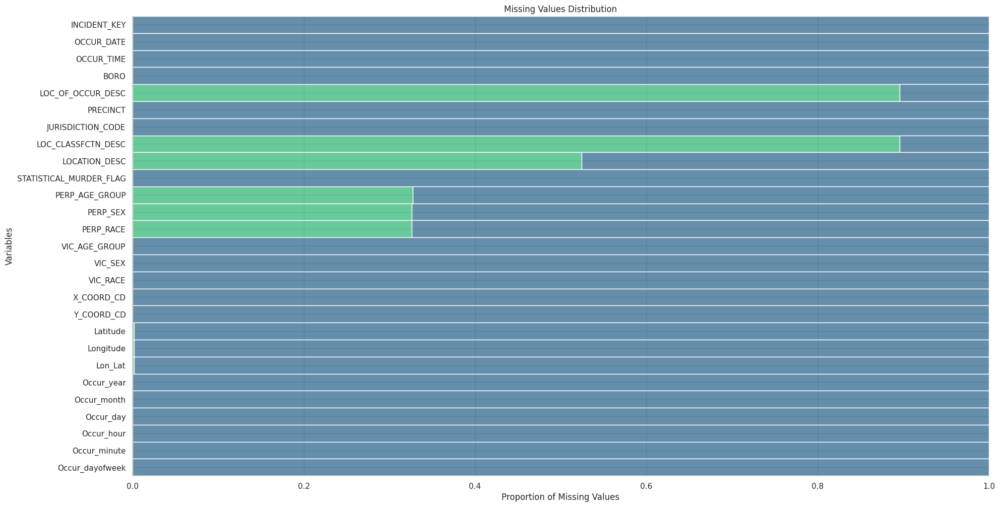

In [57]:
# Graficamos para ver la distribución de los nulos
(dfgraf:= df.isnull().melt()).pipe(
    lambda df: (
        sns.displot(
            data=df,
            y='variable',
            hue='value',
            multiple='fill',
            aspect=2,         # Reducir el aspect ratio para que sea más ancho
            height=10,        # Ajustar la altura del gráfico
            palette='viridis',# Cambiar la paleta de colores
            legend=False       # Desactivar la leyenda para ahorrar espacio
        )
    )
)

# Añadir etiquetas
plt.title('Missing Values Distribution')
plt.xlabel('Proportion of Missing Values')
plt.ylabel('Variables')
plt.show()

In [58]:
df.isnull().sum()

,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25596
LOCATION_DESC,14977
STATISTICAL_MURDER_FLAG,0


In [59]:
# Resumimos todo con un contador de valores nulos por cada variable
nulos_por_variable = df.isnull()
cantidad_nulos_por_variable = nulos_por_variable.sum() # Sumamos los valores booleanos para obtener la cantidad de nulos por variable
variables_con_nulos = cantidad_nulos_por_variable[cantidad_nulos_por_variable > 0] # Filtramos solo las variables con al menos un valor nulo
lista_variables_con_nulos = variables_con_nulos.index.tolist() # Convertimos a lista

for variable in lista_variables_con_nulos:
    cantidad_nulos = cantidad_nulos_por_variable[variable]
    porcentaje_nulos = (cantidad_nulos / len(df)) * 100
    print(f"Variable: {variable}, Cantidad de Nulos: {cantidad_nulos}, Porcentaje: {porcentaje_nulos:.2f}%")

Variable: LOC_OF_OCCUR_DESC, Cantidad de Nulos: 25596, Porcentaje: 89.62%
Variable: JURISDICTION_CODE, Cantidad de Nulos: 2, Porcentaje: 0.01%
Variable: LOC_CLASSFCTN_DESC, Cantidad de Nulos: 25596, Porcentaje: 89.62%
Variable: LOCATION_DESC, Cantidad de Nulos: 14977, Porcentaje: 52.44%
Variable: PERP_AGE_GROUP, Cantidad de Nulos: 9344, Porcentaje: 32.71%
Variable: PERP_SEX, Cantidad de Nulos: 9310, Porcentaje: 32.60%
Variable: PERP_RACE, Cantidad de Nulos: 9310, Porcentaje: 32.60%
Variable: Latitude, Cantidad de Nulos: 59, Porcentaje: 0.21%
Variable: Longitude, Cantidad de Nulos: 59, Porcentaje: 0.21%
Variable: Lon_Lat, Cantidad de Nulos: 59, Porcentaje: 0.21%


In [60]:
# Rellenar valores nulos en 'transaction_type con la moda
df['PERP_AGE_GROUP'].fillna(df['PERP_AGE_GROUP'].mode()[0], inplace=True)

In [61]:
df.isnull().sum()


,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25596
LOCATION_DESC,14977
STATISTICAL_MURDER_FLAG,0


In [62]:
print(df['PERP_RACE'].unique())

['BLACK' '(null)' nan 'UNKNOWN' 'WHITE HISPANIC' 'BLACK HISPANIC'
 'ASIAN / PACIFIC ISLANDER' 'WHITE' 'AMERICAN INDIAN/ALASKAN NATIVE']


In [63]:
valores_nulos = df[df['Latitude'].isnull()]
valores_nulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
2670,251690448,2022-09-27,23:30:00,MANHATTAN,OUTSIDE,28,0.0,STREET,(null),False,...,233806.0,NaN,NaN,NaN,2022,9,27,23,30,1
3426,254053457,2022-11-13,01:00:00,QUEENS,OUTSIDE,110,0.0,PLAYGROUND,(null),False,...,210169.0,NaN,NaN,NaN,2022,11,13,1,0,6
3932,250460651,2022-09-01,01:15:00,QUEENS,OUTSIDE,103,0.0,OTHER,(null),False,...,197008.0,NaN,NaN,NaN,2022,9,1,1,15,3
4042,251690448,2022-09-27,23:30:00,MANHATTAN,OUTSIDE,28,0.0,STREET,(null),False,...,233806.0,NaN,NaN,NaN,2022,9,27,23,30,1
4182,250340401,2022-08-30,00:10:00,BROOKLYN,OUTSIDE,84,0.0,STREET,(null),False,...,192641.0,NaN,NaN,NaN,2022,8,30,0,10,1
8748,252281471,2022-10-09,19:15:00,BROOKLYN,OUTSIDE,61,0.0,HOUSING,MULTI DWELL - PUBLIC HOUS,False,...,155693.0,NaN,NaN,NaN,2022,10,9,19,15,6
9980,259091227,2022-12-19,23:23:00,BROOKLYN,OUTSIDE,60,0.0,STREET,(null),False,...,149362.0,NaN,NaN,NaN,2022,12,19,23,23,0
13316,251253188,2022-09-18,03:40:00,MANHATTAN,OUTSIDE,34,0.0,STREET,(null),False,...,249401.0,NaN,NaN,NaN,2022,9,18,3,40,6
14238,250584475,2022-09-03,22:45:00,BROOKLYN,OUTSIDE,90,0.0,STREET,(null),False,...,196692.0,NaN,NaN,NaN,2022,9,3,22,45,5
15724,255042633,2022-12-03,10:21:00,MANHATTAN,OUTSIDE,33,0.0,STREET,(null),False,...,245600.0,NaN,NaN,NaN,2022,12,3,10,21,5


In [64]:
df_sin_nulos = df.dropna(subset=['Latitude'])
df_sin_nulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,LOC_OF_OCCUR_DESC,PRECINCT,JURISDICTION_CODE,LOC_CLASSFCTN_DESC,LOCATION_DESC,STATISTICAL_MURDER_FLAG,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,INSIDE,14,0.0,COMMERCIAL,VIDEO STORE,True,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,OUTSIDE,48,0.0,STREET,(null),True,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,NaN,103,0.0,NaN,NaN,False,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,NaN,42,0.0,NaN,NaN,False,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,NaN,83,0.0,NaN,NaN,False,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,INSIDE,47,0.0,COMMERCIAL,GROCERY/BODEGA,True,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,OUTSIDE,41,0.0,STREET,(null),False,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,INSIDE,41,0.0,DWELLING,MULTI DWELL - APT BUILD,True,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,OUTSIDE,102,0.0,STREET,BEAUTY/NAIL SALON,False,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [65]:
df_sin_nulos.isnull().sum()


,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25596
LOCATION_DESC,14977
STATISTICAL_MURDER_FLAG,0


In [66]:
df_sin_nulos['PERP_SEX'].fillna(df['PERP_SEX'].mode()[0], inplace=True)
df_sin_nulos['PERP_RACE'].fillna(df['PERP_RACE'].mode()[0], inplace=True)


In [67]:
df_sin_nulos.isnull().sum()

,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
LOC_OF_OCCUR_DESC,25596
PRECINCT,0
JURISDICTION_CODE,2
LOC_CLASSFCTN_DESC,25596
LOCATION_DESC,14977
STATISTICAL_MURDER_FLAG,0


In [70]:
df_sin_nulos = df_sin_nulos.drop(columns=['LOCATION_DESC', 'LOC_CLASSFCTN_DESC','LOC_OF_OCCUR_DESC','JURISDICTION_CODE'])
df_sin_nulos

KeyError: "['LOCATION_DESC', 'LOC_CLASSFCTN_DESC', 'LOC_OF_OCCUR_DESC', 'JURISDICTION_CODE'] not found in axis"

In [71]:
df_sin_nulos.isnull().sum()

,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
PRECINCT,0
STATISTICAL_MURDER_FLAG,0
PERP_AGE_GROUP,0
PERP_SEX,0
PERP_RACE,0
VIC_AGE_GROUP,0


In [72]:
df_sin_nulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,14,True,25-44,M,BLACK,25-44,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,48,True,(null),(null),(null),18-24,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,103,False,18-24,M,BLACK,18-24,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,42,False,25-44,M,UNKNOWN,25-44,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,83,False,25-44,M,BLACK,25-44,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,47,True,18-24,M,BLACK,18-24,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,41,False,25-44,F,BLACK,45-64,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,41,True,25-44,M,BLACK,25-44,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,102,False,25-44,M,WHITE HISPANIC,65+,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [75]:
df_sin_nulos['PERP_SEX'].fillna(df['PERP_SEX'].mode()[0], inplace=True)
df_sin_nulos['PERP_RACE'].fillna(df['PERP_RACE'].mode()[0], inplace=True)
df_sin_nulos['PERP_AGE_GROUP'].fillna(df['PERP_AGE_GROUP'].mode()[0], inplace=True)

In [76]:
df_sin_nulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,14,True,25-44,M,BLACK,25-44,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,48,True,(null),(null),(null),18-24,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,103,False,18-24,M,BLACK,18-24,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,42,False,25-44,M,UNKNOWN,25-44,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,83,False,25-44,M,BLACK,25-44,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,47,True,18-24,M,BLACK,18-24,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,41,False,25-44,F,BLACK,45-64,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,41,True,25-44,M,BLACK,25-44,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,102,False,25-44,M,WHITE HISPANIC,65+,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [77]:
# Reemplazar los valores (null) con NaN
df_sin_nulos.replace('(null)', pd.NA, inplace=True)

# Reemplazar los valores NaN con la moda de cada columna
for column in df_sin_nulos.columns:
    mode_value = df_sin_nulos[column].mode()[0]
    df_sin_nulos[column].fillna(mode_value, inplace=True)

In [78]:
df_sin_nulos

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,...,Y_COORD_CD,Latitude,Longitude,Lon_Lat,Occur_year,Occur_month,Occur_day,Occur_hour,Occur_minute,Occur_dayofweek
0,244608249,2022-05-05,00:10:00,MANHATTAN,14,True,25-44,M,BLACK,25-44,...,214231.000000,40.754692,-73.993500,POINT (-73.9935 40.754692),2022,5,5,0,10,3
1,247542571,2022-07-04,22:20:00,BRONX,48,True,18-24,M,BLACK,18-24,...,250581.000000,40.854402,-73.882330,POINT (-73.88233 40.854402),2022,7,4,22,20,0
2,84967535,2012-05-27,19:35:00,QUEENS,103,False,18-24,M,BLACK,18-24,...,198262.000000,40.710634,-73.767773,POINT (-73.76777349199995 40.71063412500007),2012,5,27,19,35,6
3,202853370,2019-09-24,21:00:00,BRONX,42,False,25-44,M,UNKNOWN,25-44,...,242565.000000,40.832417,-73.890714,POINT (-73.89071440599997 40.832416753000075),2019,9,24,21,0,1
4,27078636,2007-02-25,21:00:00,BROOKLYN,83,False,25-44,M,BLACK,25-44,...,190104.703125,40.688443,-73.910219,POINT (-73.91021857399994 40.68844345900004),2007,2,25,21,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28557,265354835,2023-03-19,23:48:00,BRONX,47,True,18-24,M,BLACK,18-24,...,268586.000000,40.903785,-73.850098,POINT (-73.850098 40.903785),2023,3,19,23,48,6
28558,272968931,2023-08-16,02:46:00,BRONX,41,False,25-44,F,BLACK,45-64,...,240066.000000,40.825549,-73.890195,POINT (-73.890195 40.825549),2023,8,16,2,46,2
28559,270489846,2023-06-27,12:27:00,BRONX,41,True,25-44,M,BLACK,25-44,...,238552.000000,40.821404,-73.898938,POINT (-73.898938 40.821404),2023,6,27,12,27,1
28560,271021661,2023-07-08,11:27:00,QUEENS,102,False,25-44,M,WHITE HISPANIC,65+,...,192785.000000,40.695717,-73.839138,POINT (-73.839138 40.695717),2023,7,8,11,27,5


In [79]:
df_sin_nulos.isnull().sum()

,0
INCIDENT_KEY,0
OCCUR_DATE,0
OCCUR_TIME,0
BORO,0
PRECINCT,0
STATISTICAL_MURDER_FLAG,0
PERP_AGE_GROUP,0
PERP_SEX,0
PERP_RACE,0
VIC_AGE_GROUP,0
